In [18]:
%matplotlib inline
import pylab
import matplotlib.pyplot as plt
import numpy.ma as ma
import numpy as np

import pcraster as pcr
import rasterio as rio
pylab.rcParams['figure.figsize'] = (15.0, 15.0)

In [19]:
!pwd

/mnt/data2/GlobalHAND30/notebooks


In [22]:
# Create PCRaster MAP file to be used as a template? !#$!@#$!@#$
!gdal_translate -a_nodata 0 -of PCRaster -ot Float32 ../output/continents/dem/SRTM_30_Europe_2070476090.dem.tif ../temp/clone.map
!gdalinfo ../temp/clone.map

Input file size is 5382, 4511
0...10...20...30...40...50...60...70...80...90...100 - done.
Driver: PCRaster/PCRaster Raster File
Files: ../temp/clone.map
       ../temp/clone.map.aux.xml
Size is 5382, 4511
Coordinate System is:
GEOGCS["WGS 84",
    DATUM["WGS_1984",
        SPHEROID["WGS 84",6378137,298.257223563,
            AUTHORITY["EPSG","7030"]],
        AUTHORITY["EPSG","6326"]],
    PRIMEM["Greenwich",0],
    UNIT["degree",0.0174532925199433],
    AUTHORITY["EPSG","4326"]]
Origin = (12.052638888888879,48.247361111111111)
Pixel Size = (0.000277777777778,-0.000277777777778)
Metadata:
  PCRASTER_VALUESCALE=VS_SCALAR
Corner Coordinates:
Upper Left  (  12.0526389,  48.2473611) ( 12d 3' 9.50"E, 48d14'50.50"N)
Lower Left  (  12.0526389,  46.9943056) ( 12d 3' 9.50"E, 46d59'39.50"N)
Upper Right (  13.5476389,  48.2473611) ( 13d32'51.50"E, 48d14'50.50"N)
Lower Right (  13.5476389,  46.9943056) ( 13d32'51.50"E, 46d59'39.50"N)
Center      (  12.8001389,  47.6208333) ( 12d48' 0.50"E, 47d37'

In [23]:
#pcr.setglobaloption('unitcell')
pcr.setglobaloption('unittrue')

pcr.setclone('../temp/clone.map')

In [24]:
result = pcr.celllength()
pcr.pcr2numpy(result, -9999).max()

0.00027777778

In [26]:
path = '../output/continents/dem/SRTM_30_Europe_2070476090.dem.tif'
dem = rio.open(path).read()
dem = ma.masked_equal(dem[0], -9999)

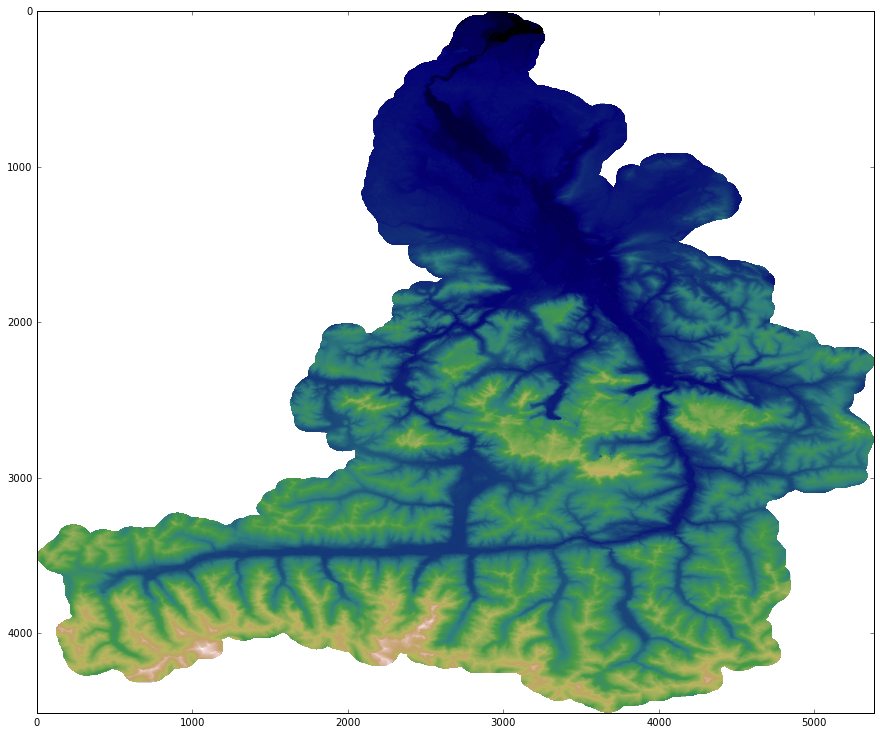

In [27]:
plt.imshow(dem, cmap='gist_earth')

In [5]:
path = '../output/continents/hand-100/SRTM_30_Europe_2070476090_hand.tif'
hand = rio.open(path).read()
hand = ma.masked_less(hand[0], 0)

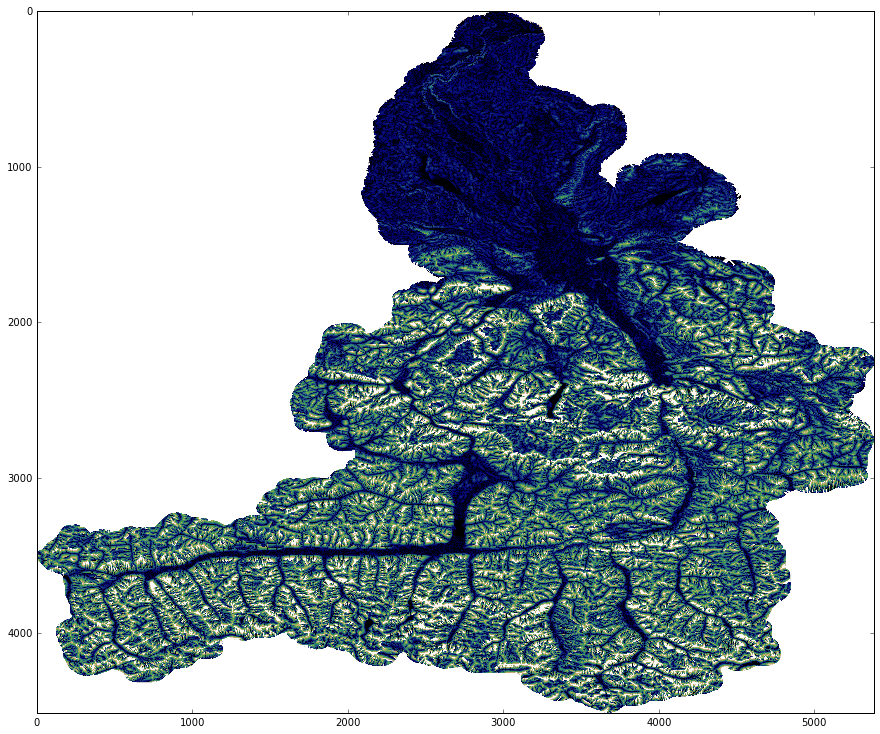

In [9]:
plt.imshow(hand, cmap='gist_earth', vmax=400)

In [9]:
path = '../output/continents/Europe/SRTM_30_Europe_2070476090_dist.tif'
dist = rio.open(path).read()
dist = ma.masked_less(dist[0], 0)

/usr/local/lib/python2.7/dist-packages/matplotlib/colors.py:950: RuntimeWarning: overflow encountered in true_divide
  resdat /= (vmax - vmin)


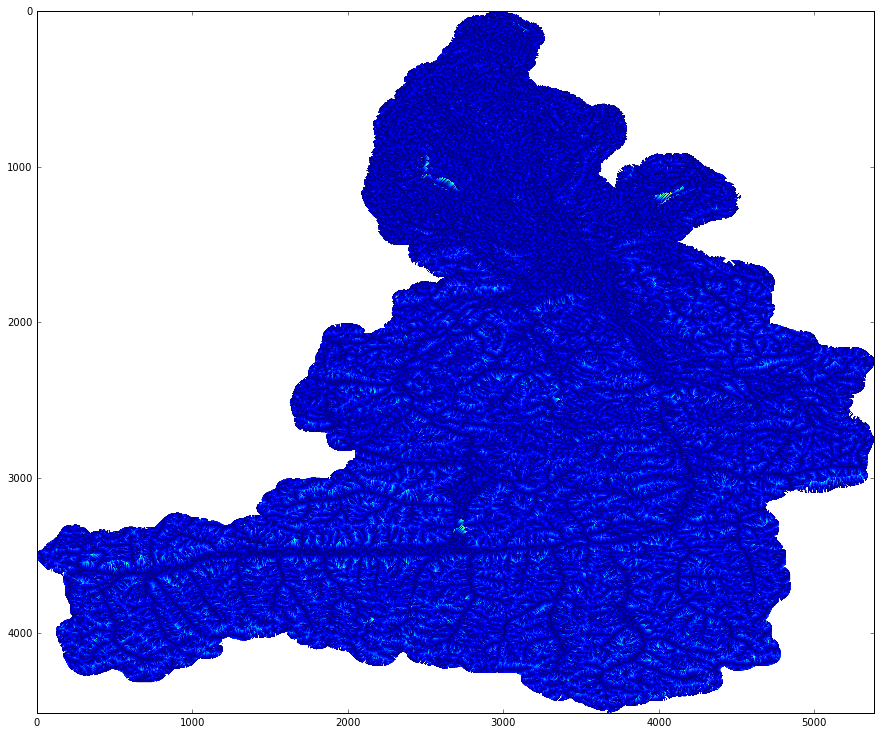

In [11]:
plt.imshow(dist)

In [28]:
path = '../output/continents/ldd/SRTM_30_Europe_2070476090_ldd.tif'
ldd = rio.open(path).read()
ldd = ma.masked_equal(ldd[0], 255)

ldd_pcr = pcr.numpy2pcr(pcr.Ldd, ldd, 255)

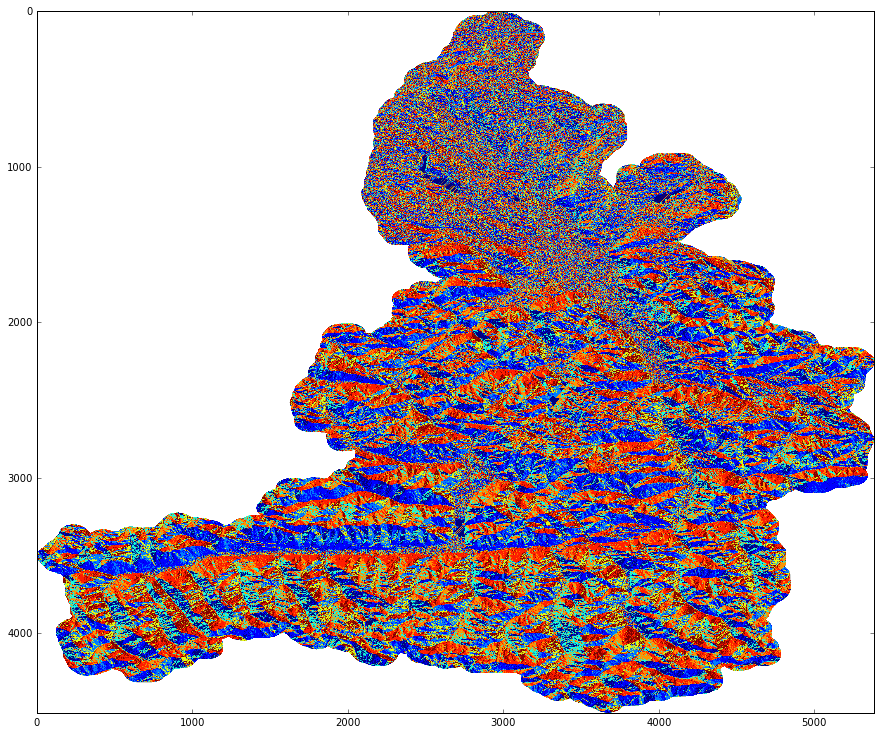

In [29]:
plt.imshow(ldd)

In [29]:
path = '../output/continents/Europe/SRTM_30_Europe_2070476090_catchments.tif'
catchments = rio.open(path).read()
catchments = ma.masked_less(catchments[0], 0)

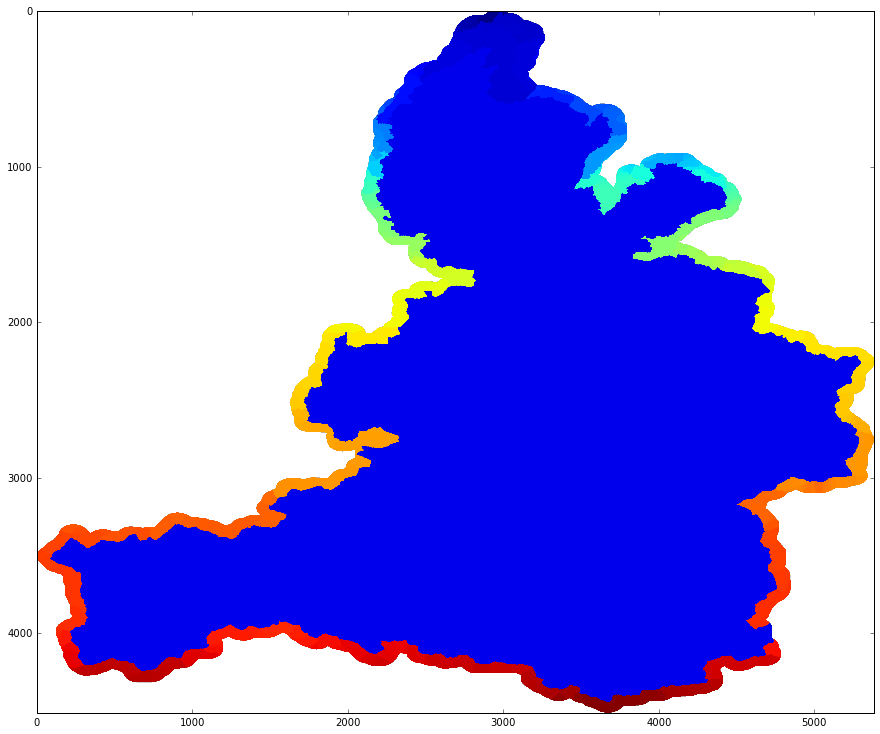

In [ ]:
plt.imshow(catchments)

In [422]:
path = '../output/continents/Europe/SRTM_30_Europe_2070476090_dem_pits_diff.tif'
pits_diff = rio.open(path).read()
pits_diff = ma.masked_less(pits_diff[0], 0)

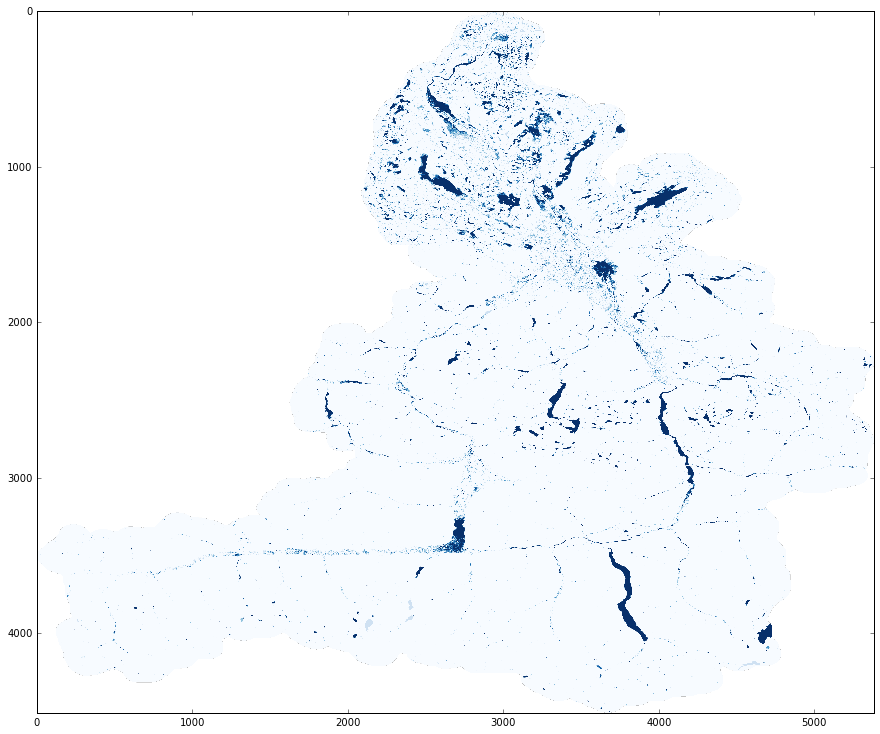

In [12]:
plt.imshow(pits_diff, cmap='Blues',vmax=5)

In [35]:
path = '/mnt/data2/GlobalHAND30/continents/Europe/SRTM_30_Europe_2070476090_fa.tif'
fa = rio.open(path).read()
fa = ma.masked_less_equal(fa[0], 0)

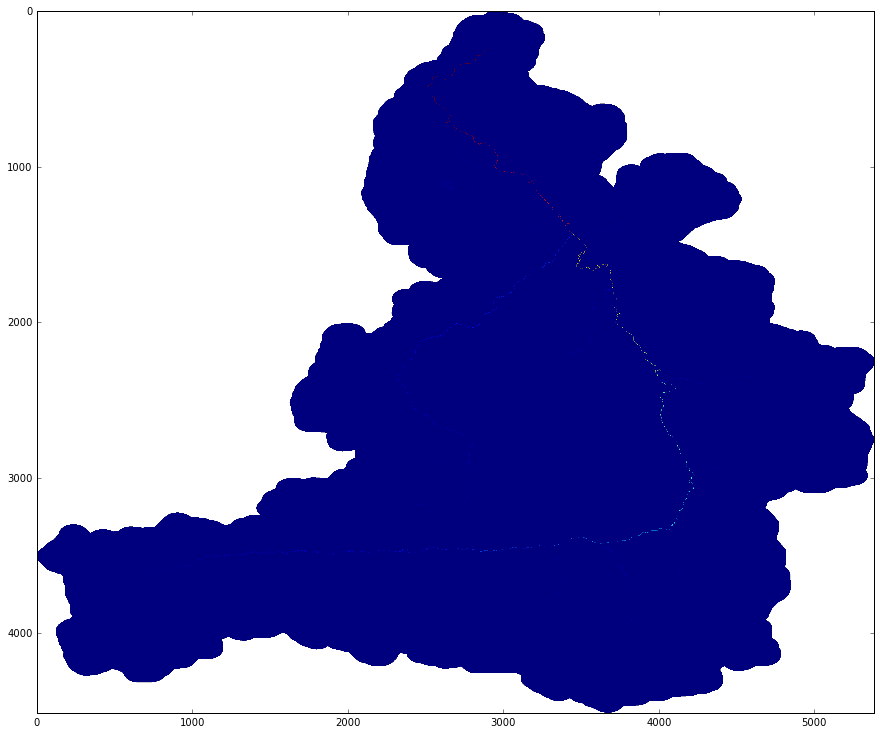

In [14]:
plt.imshow(fa)

In [32]:
path = '../output/continents/Europe/SRTM_30_Europe_2070476090_faand.tif'
faand = rio.open(path).read()
faand = ma.masked_less_equal(faand[0], 0)

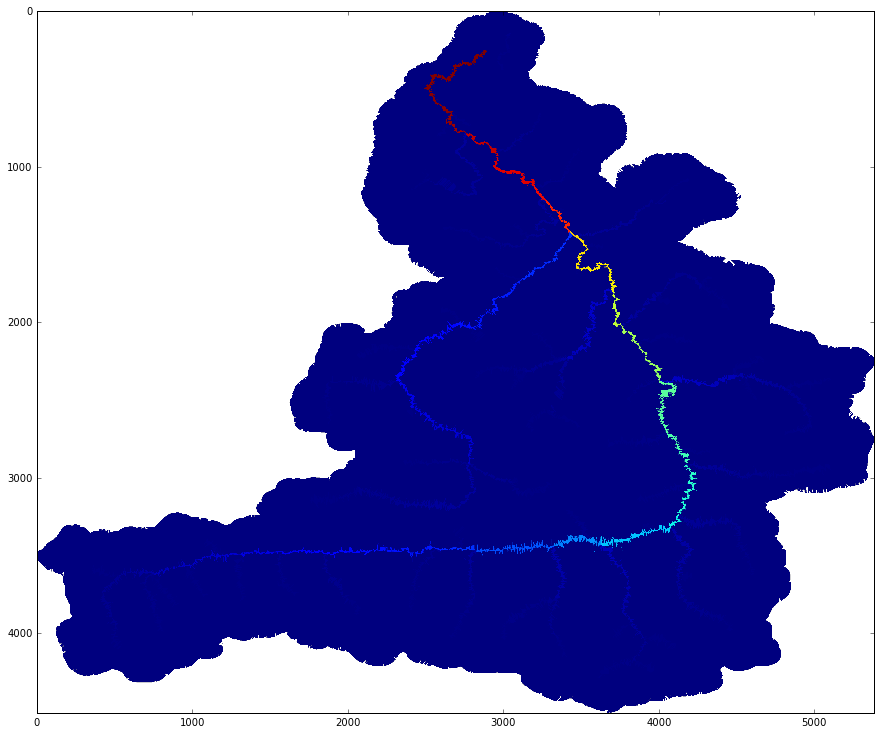

In [16]:
plt.imshow(faand, vmin=1)

## Experiments, a better HAND estimation algorithm

In [30]:
xmin=3250
xmax=3750
ymin=3000
ymax=3500

ymin=2000
ymax=2500
xmin=3200
xmax=3700

/usr/local/lib/python2.7/dist-packages/numpy-1.12.0.dev0+12ec338-py2.7-linux-x86_64.egg/numpy/ma/core.py:3192: FutureWarning: Currently, slicing will try to return a view of the data, but will return a copy of the mask. In the future, it will try to return both as views. This means that using `__setitem__` will propagate values back through all masks that are present.
  FutureWarning


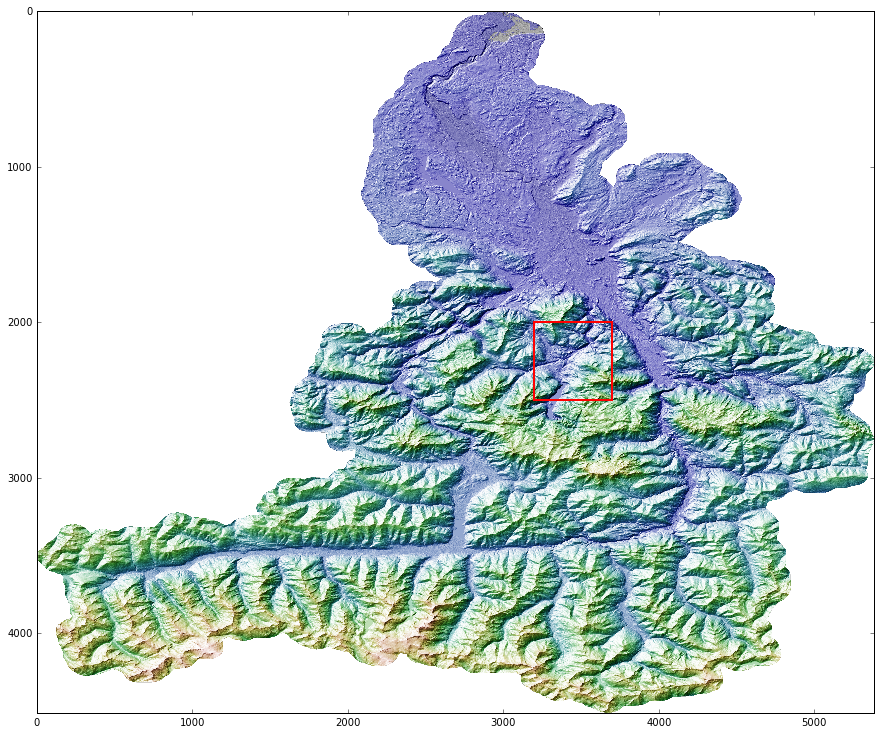

In [33]:
from matplotlib.colors import LightSource
ls = LightSource(azdeg=315, altdeg=45)

rgb = ls.shade(dem, cmap=plt.cm.gist_earth, blend_mode='hsv', vert_exag=0.1)
plt.imshow(rgb)

import matplotlib.patches as patches

currentAxis = plt.gca()
rect = patches.Rectangle(
        (xmin, ymin),   # (x,y)
        xmax-xmin,      # width
        ymax-ymin,      # height
        fill=False,
        edgecolor='red', linewidth=2)

currentAxis.add_patch(rect)

In [31]:
def show_dem_and_fa(fa_threshold):
    fig, ax = plt.subplots()

    ls = LightSource(azdeg=315, altdeg=70)
    rgb = ls.shade(dem[ymin:ymax, xmin:xmax], cmap=plt.cm.gist_earth, 
                blend_mode='overlay', vert_exag=0.3, vmin=500, vmax=3000)
    im_dem3d=plt.imshow(rgb)

    th = fa_threshold
    z = fa[ymin:ymax, xmin:xmax]
    v = ma.masked_less(z, th)
    im_fa = plt.imshow(v, cmap=plt.cm.Reds_r, alpha=0.7, interpolation='nearest', vmin=0, vmax=1)

    plt.show()

NameError: global name 'fa' is not defined

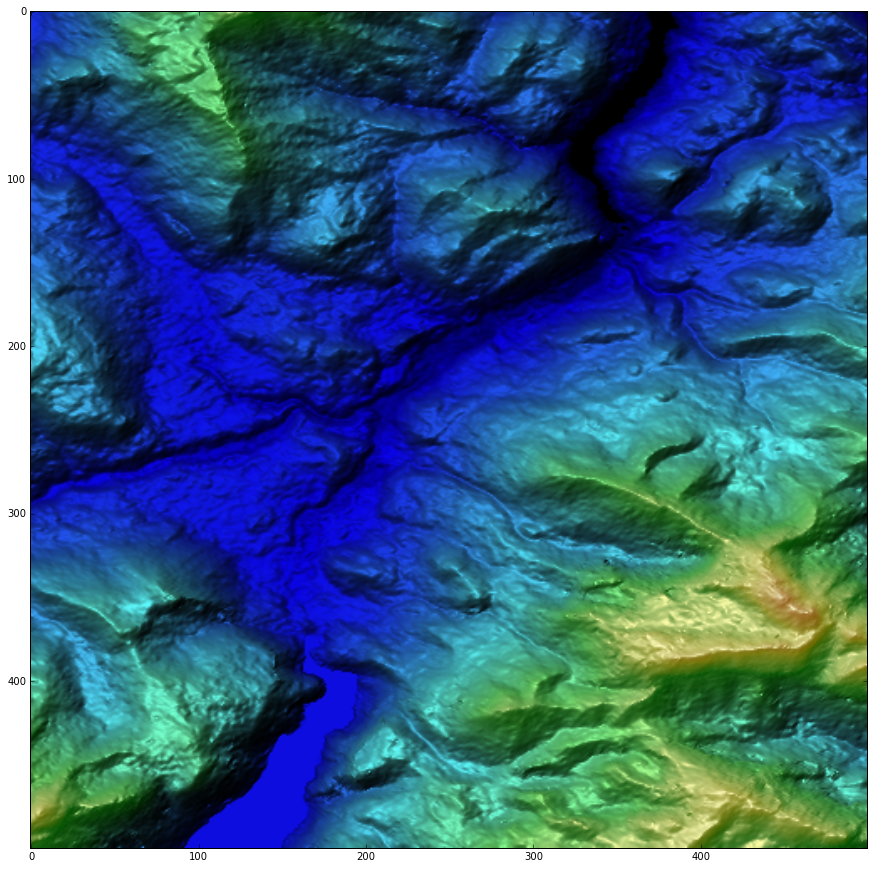

In [34]:
show_dem_and_fa(100)

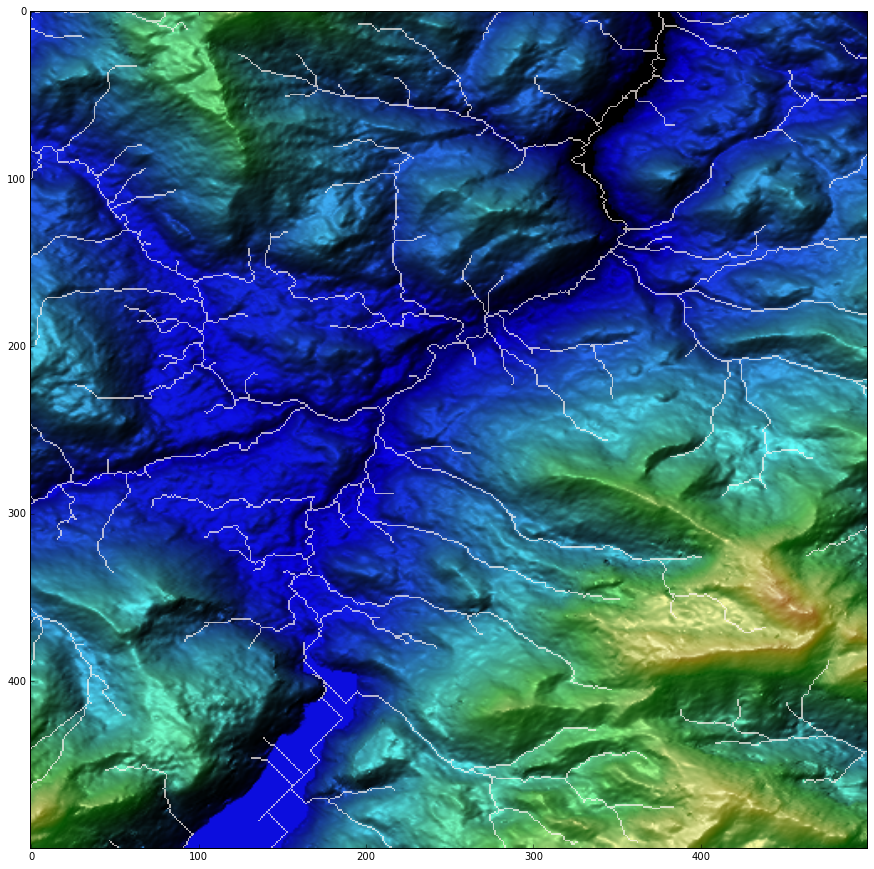

In [170]:
show_dem_and_fa(500)

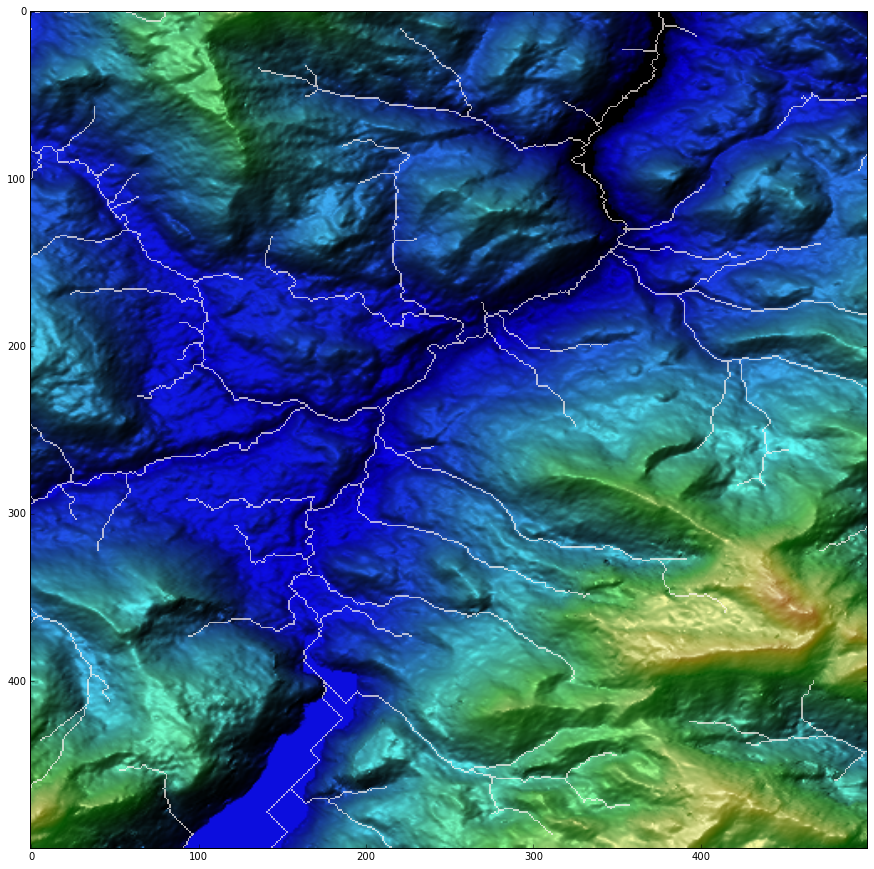

In [168]:
show_dem_and_fa(1000)

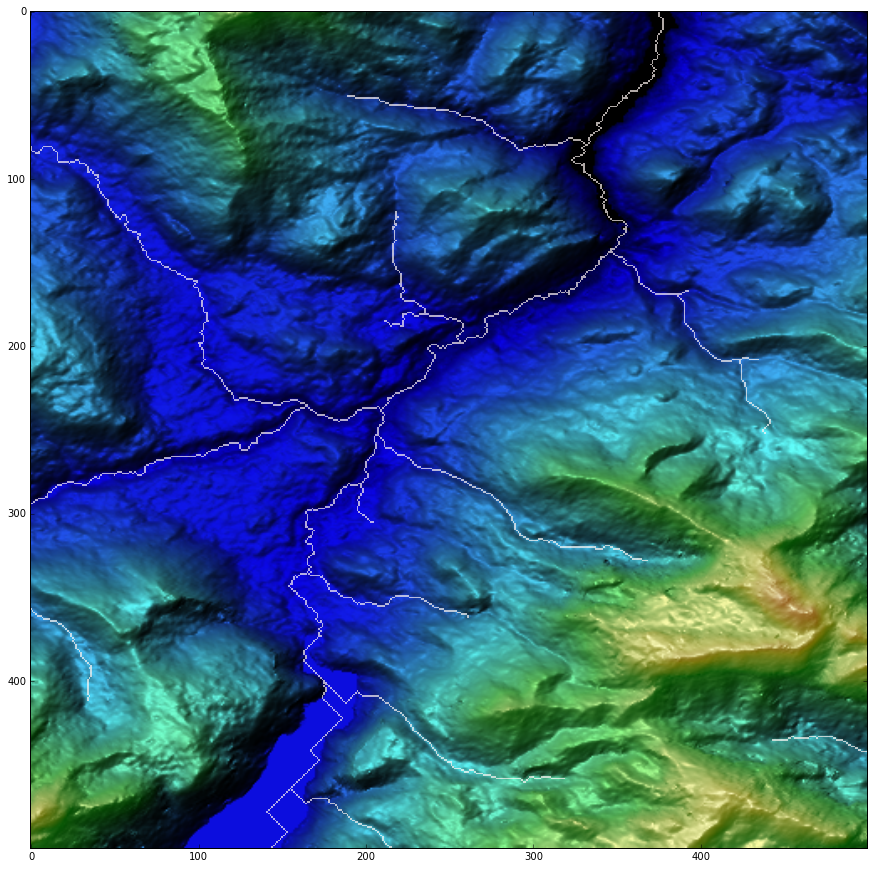

In [171]:
show_dem_and_fa(5000)

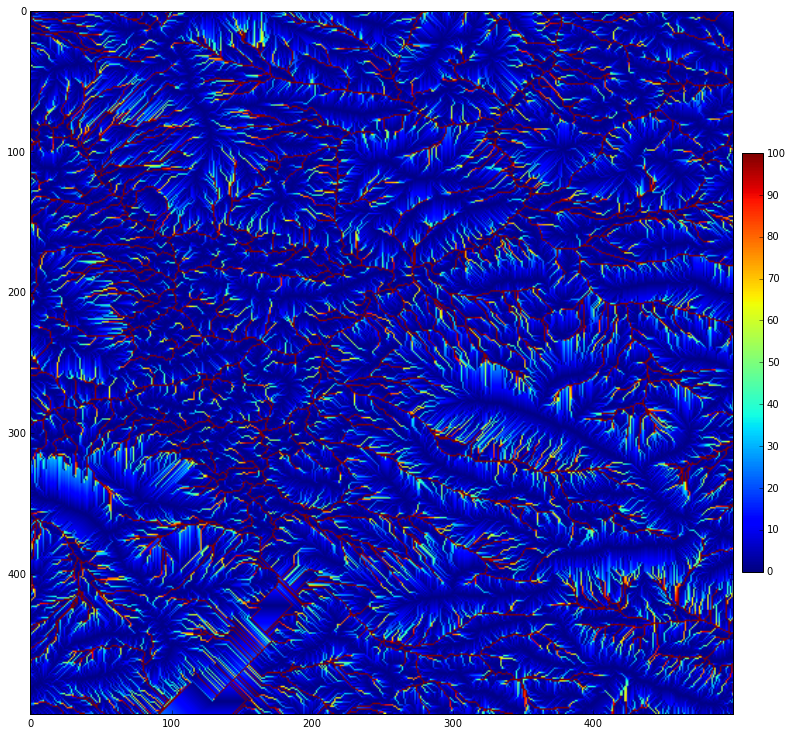

In [453]:
im = plt.imshow(fa[ymin:ymax, xmin:xmax],vmin=0, vmax=100)
plt.colorbar(im, shrink=0.5, pad = 0.01)

In [36]:
fa_pcr = pcr.numpy2pcr(pcr.Scalar, np.power(fa, -0.7), -9999)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:1: RuntimeWarning: invalid value encountered in power
  if __name__ == '__main__':


In [36]:
total_fa_pcr = pcr.accuflux(ldd_pcr, fa_pcr)
total_fa = pcr.pcr2numpy(total_fa_pcr, -9999)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:1: RuntimeWarning: invalid value encountered in power
  if __name__ == '__main__':


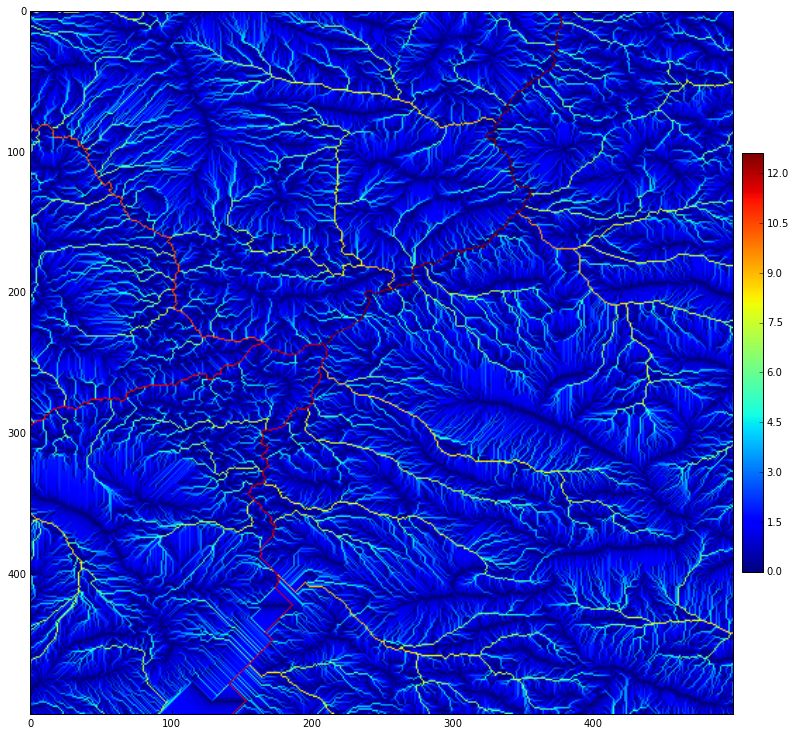

In [52]:
im = plt.imshow(np.log(total_fa[ymin:ymax, xmin:xmax]))
plt.colorbar(im, shrink=0.5, pad = 0.01)

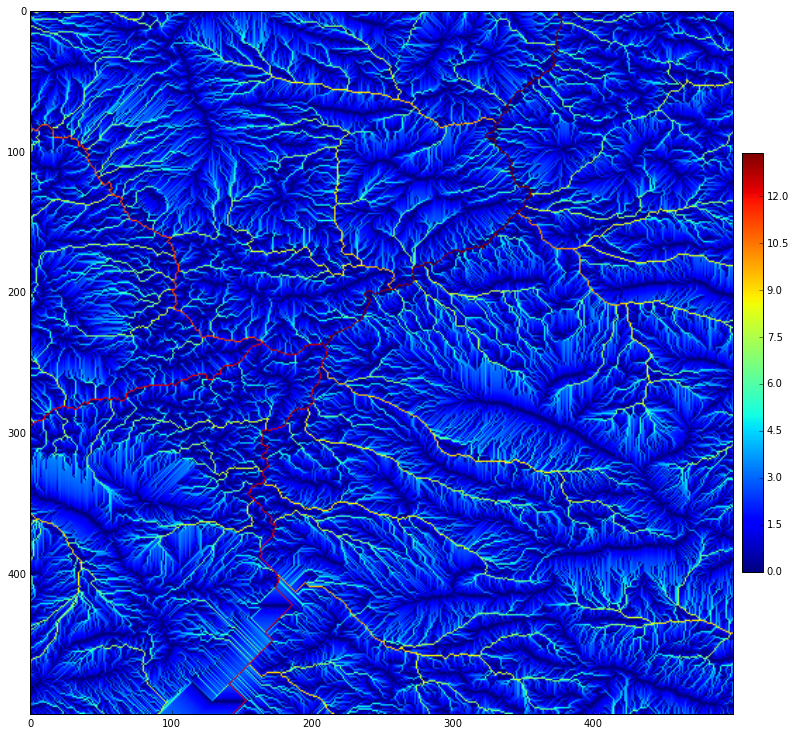

In [50]:
im = plt.imshow(np.log(fa[ymin:ymax, xmin:xmax]))
plt.colorbar(im, shrink=0.5, pad = 0.01)

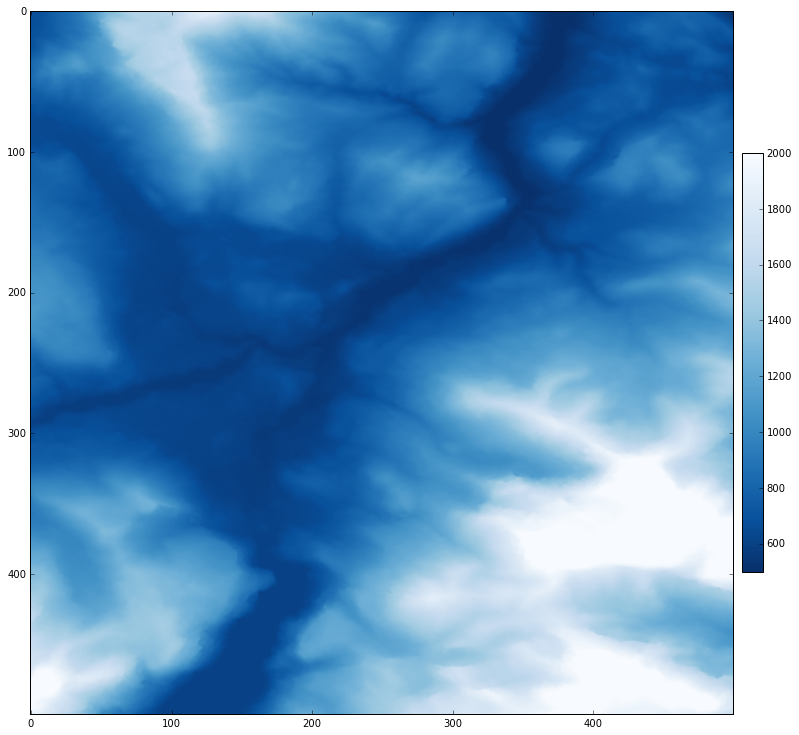

In [429]:
im_dem = plt.imshow(dem[ymin:ymax, xmin:xmax], cmap='Blues_r', vmin=500, vmax=2000)
plt.colorbar(im_dem, shrink=0.5, pad = 0.01)

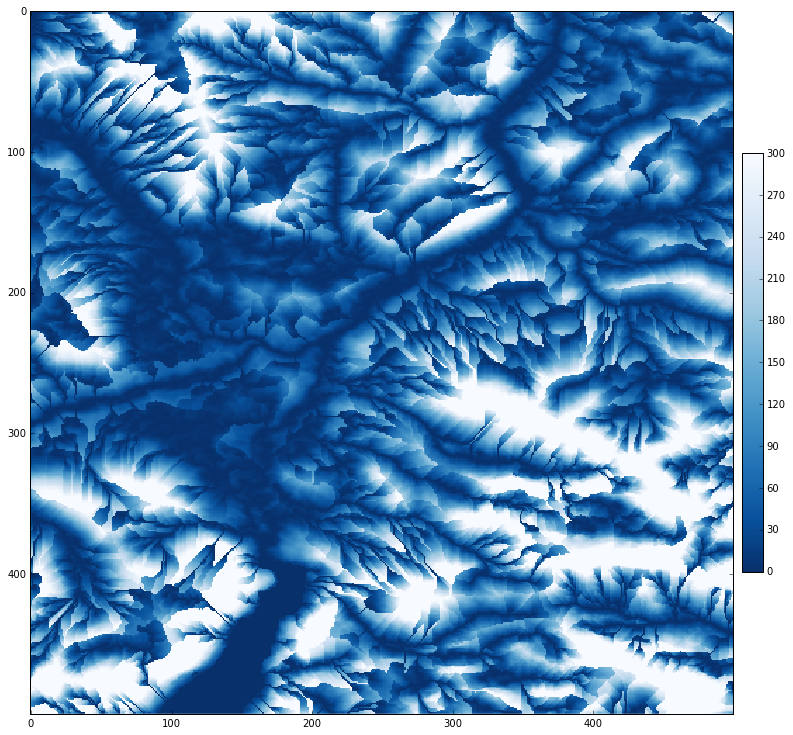

In [430]:
im_hand = plt.imshow(hand[ymin:ymax, xmin:xmax], cmap=plt.cm.Blues_r, vmin=0, vmax=300, interpolation='none')
plt.colorbar(im_hand, shrink=0.5, pad = 0.01)

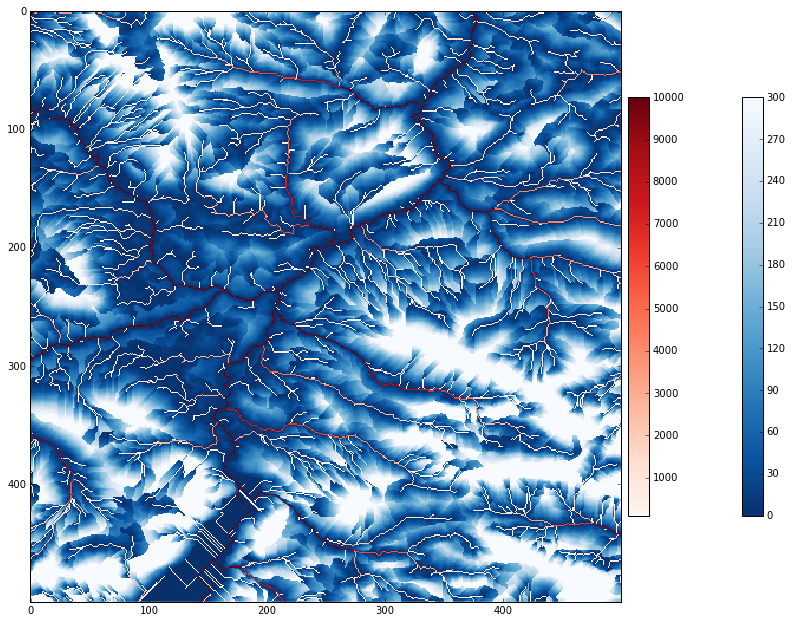

In [431]:
im_hand = plt.imshow(hand[ymin:ymax, xmin:xmax], cmap=plt.cm.Blues_r, vmin=0, vmax=300, interpolation='none')
plt.colorbar(im_hand, shrink=0.5, pad = 0.01)
im_fa=plt.imshow(ma.masked_less(fa[ymin:ymax, xmin:xmax], 100), cmap=plt.cm.Reds, vmin=100, vmax=10000, interpolation='none')
plt.colorbar(im_fa, shrink=0.5, pad = 0.01)

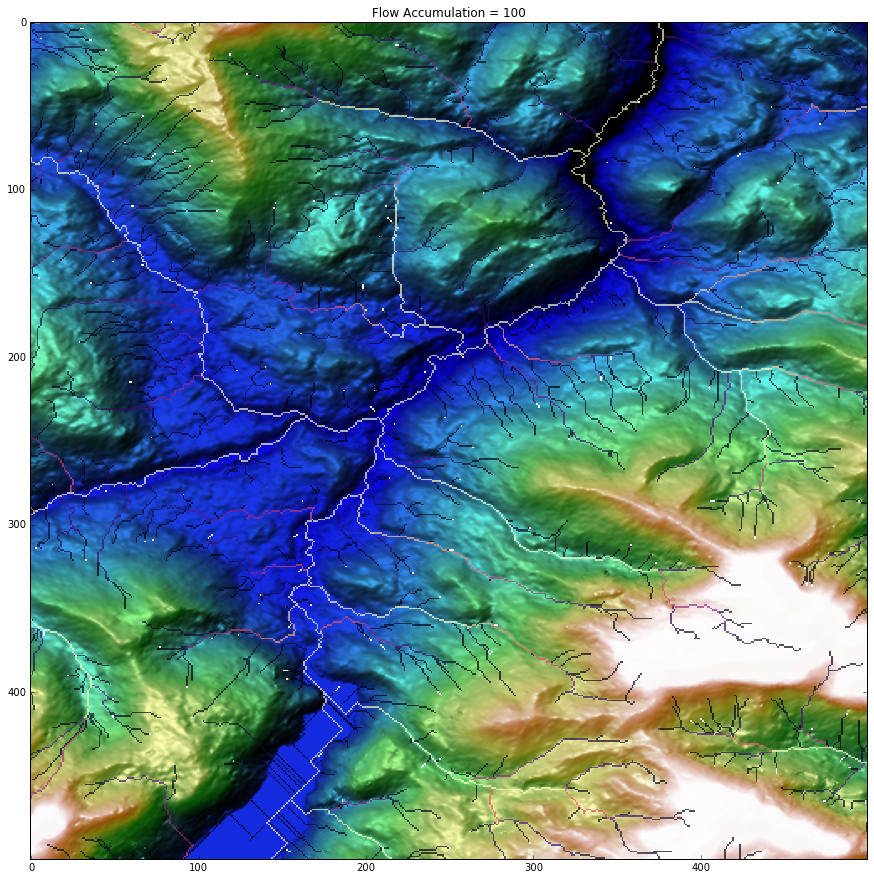

In [64]:
from matplotlib import patches
from matplotlib import animation
from matplotlib.colors import LightSource
from scipy.ndimage.morphology import binary_dilation

fig, ax = plt.subplots()

ls = LightSource(azdeg=315, altdeg=70)
rgb = ls.shade(dem[ymin:ymax, xmin:xmax], cmap=plt.cm.gist_earth, 
                blend_mode='overlay', vert_exag=0.3, vmin=500, vmax=2000)
im_dem3d=plt.imshow(rgb)

th = 100
z = fa[ymin:ymax, xmin:xmax]
v2 = ma.masked_less(ma.masked_greater(z, th), th - 3) > 0
# v2 = ma.masked_equal(binary_dilation(ma.greater(ma.masked_not_equal(z, th), 0), iterations=2), 0)
im_begin = plt.imshow(v2, cmap=plt.cm.Blues, interpolation='nearest')

v = ma.masked_less(z, th)
im_fa = plt.imshow(v, cmap=plt.cm.magma, alpha=0.7, interpolation='nearest', vmin=0, vmax=5000)
#im_colorbar = plt.colorbar(im_fa, shrink=0.3, pad = 0.01)

# im_fa = plt.imshow(v, cmap=plt.cm.Blues_r, alpha=0.7, vmin=0, vmax=1000, interpolation='nearest')
# im_colorbar = plt.colorbar(im_dem, shrink=0.5, pad = 0.01)

ax.set_title('Flow Accumulation = ' + str(th))

plt.show()

In [65]:
th = 1

# initialization function: plot the background of each frame
def init():
    v = ma.masked_less(z, th)
    im_fa.set_array(v)

    #return [im_fa]

    v = ma.masked_less(ma.masked_greater(z, th), th - 3) > 0
    # v = ma.masked_equal(binary_dilation(ma.greater(ma.masked_not_equal(z, th), 0), iterations=2), 0)
    
    im_begin.set_array(v)
    ax.set_title('Flow Accumulation = ' + str(th))

    return [im_fa, im_begin]

# animation function.  This is called sequentially
def animate(i):
    ax.set_title('Flow Accumulation = ' + str(th + i))
    
    v = ma.masked_less(z, th + i)
    im_fa.set_array(v)

    #return [im_fa]

    v = ma.masked_less(ma.masked_greater(z, th + i), th + i - 3) > 0
    # v = ma.masked_equal(binary_dilation(ma.greater(ma.masked_not_equal(z, th + i), 0), iterations=2), 0)
    im_begin.set_array(v)
    return [im_fa, im_begin]

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate, init_func=init, frames=1000, interval=5, blit=True)

# save the animation as an mp4.  This requires ffmpeg or mencoder to be
# installed.  The extra_args ensure that the x264 codec is used, so that
# the video can be embedded in html5.  You may need to adjust this for
# your system: for more information, see
# http://matplotlib.sourceforge.net/api/animation_api.html
anim.save('basic_animation.mp4', fps=20, codec='libx264')


plt.show()

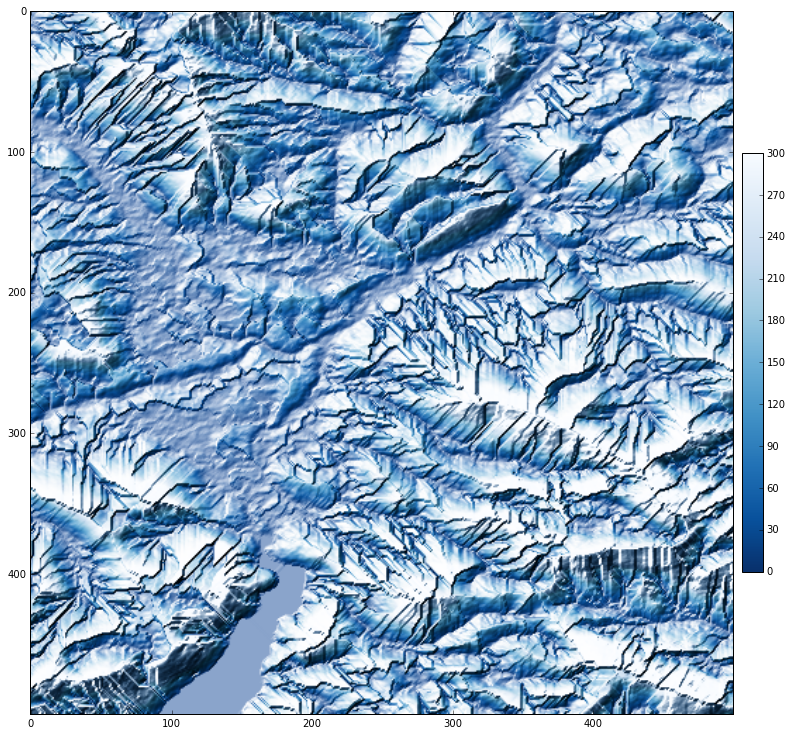

In [433]:
from matplotlib.colors import LightSource

ls = LightSource(azdeg=315, altdeg=45)

z = hand[ymin:ymax, xmin:xmax]

rgb = ls.shade(z, cmap=plt.cm.Blues_r, blend_mode='hsv', vert_exag=0.1, vmin=0, vmax=300)
plt.imshow(rgb)
plt.colorbar(im_hand, shrink=0.5, pad = 0.01)

In [10]:
pixel_size = 0.000277778 # in degrees, equal to ~30m
pixel_meters = 30

In [38]:
factor = pixel_meters / pixel_size # in ~30m units
factor

107999.91360006912

In [9]:
dem_pcr = pcr.numpy2pcr(pcr.Scalar, dem, -9999)

In [17]:
#pcr.setglobaloption('unitcell')
pcr.setglobaloption('unittrue')

# slope = dZ [m] / dX [30m in degrees]
slope_pcr = pcr.slope(dem_pcr * pixel_size)

#pcr.setglobaloption('unittrue')

In [18]:
slope = ma.masked_equal(pcr.pcr2numpy(slope_pcr,-9999), -9999)

In [86]:
print(slope.min())
print(slope.max())

0.0
396.087


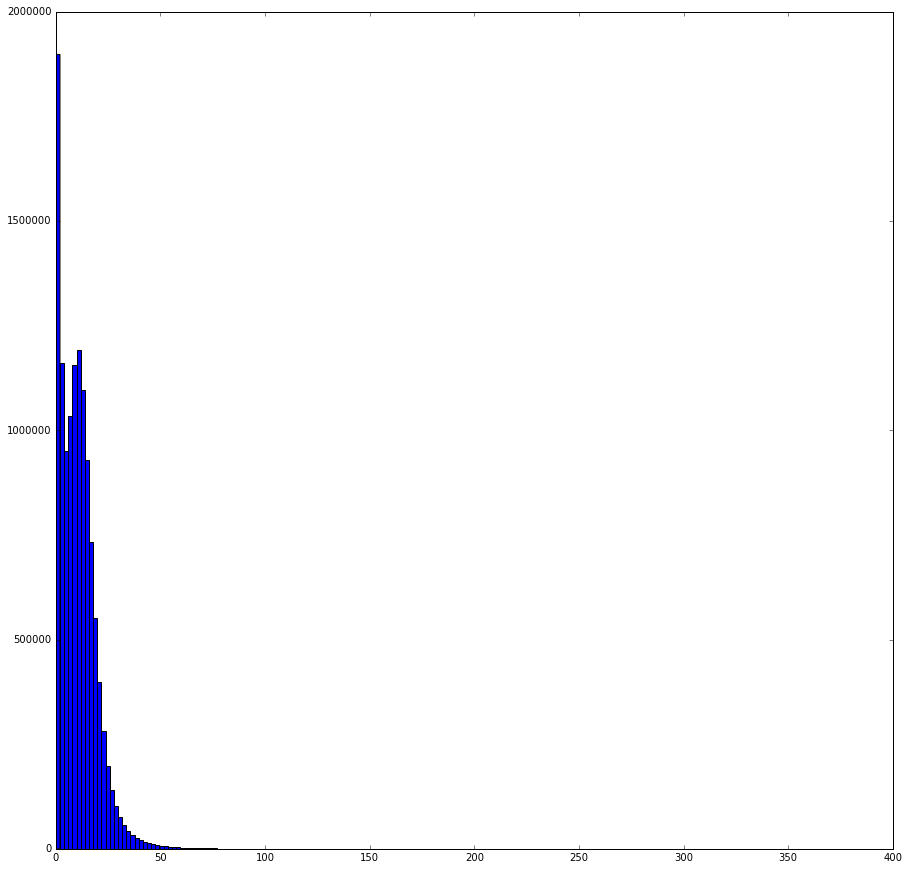

In [440]:
_ = plt.hist(slope[slope>0], bins=200)

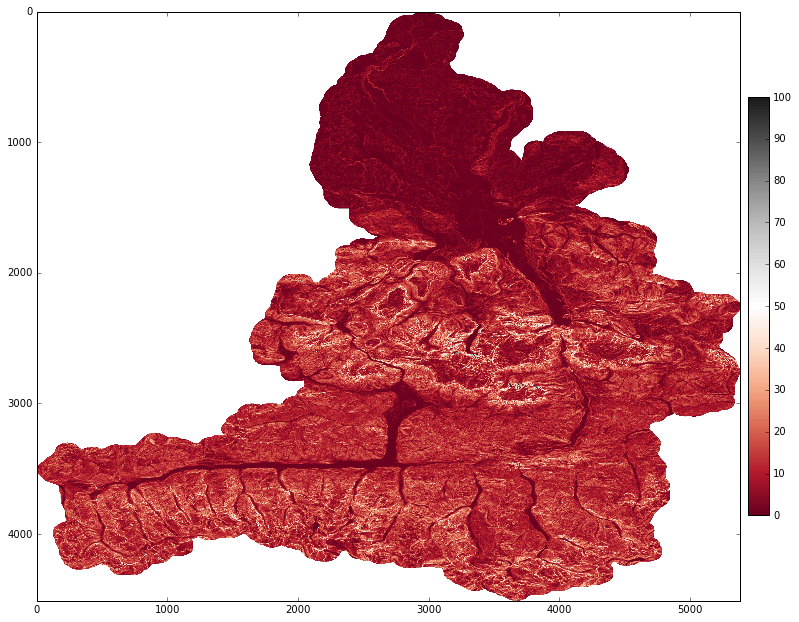

In [441]:
im = plt.imshow(slope, cmap='RdGy', vmin=0, vmax=100)
plt.colorbar(im, shrink=0.5, pad = 0.01)

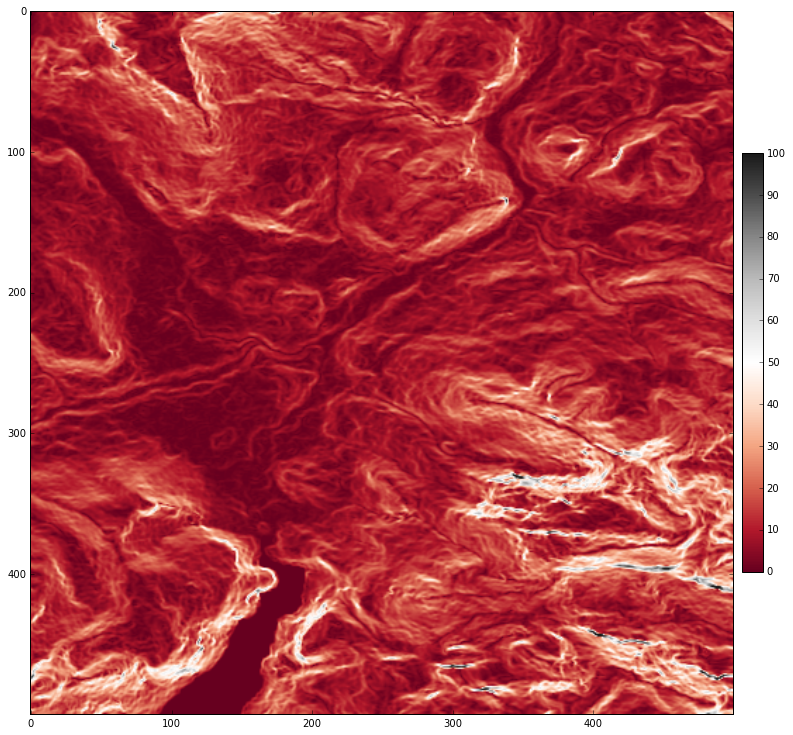

In [442]:
im = plt.imshow(slope[ymin:ymax, xmin:xmax], cmap='RdGy', vmin=0, vmax=100)
plt.colorbar(im, shrink=0.5, pad = 0.01)

In [19]:
total_slope_pcr = pcr.accuflux(ldd_pcr, slope_pcr)
total_slope = pcr.pcr2numpy(total_slope_pcr, -9999)
fa1 = fa[ymin:ymax, xmin:xmax]
total_slope1 = total_slope[ymin:ymax, xmin:xmax]
slope1 = slope[ymin:ymax, xmin:xmax]

In [40]:
# playing with a better river head detection ... not that easy
def show_drained_slope(power_fa, power_slope):
    drained_slope = np.power(fa1, power_fa) * np.power(slope1, power_slope) 

    im = plt.imshow(ma.masked_less(drained_slope, 0), cmap='Blues_r', vmin=10, vmax=16)
    plt.colorbar(im, shrink=0.5, pad = 0.01)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:5: RuntimeWarning: divide by zero encountered in log


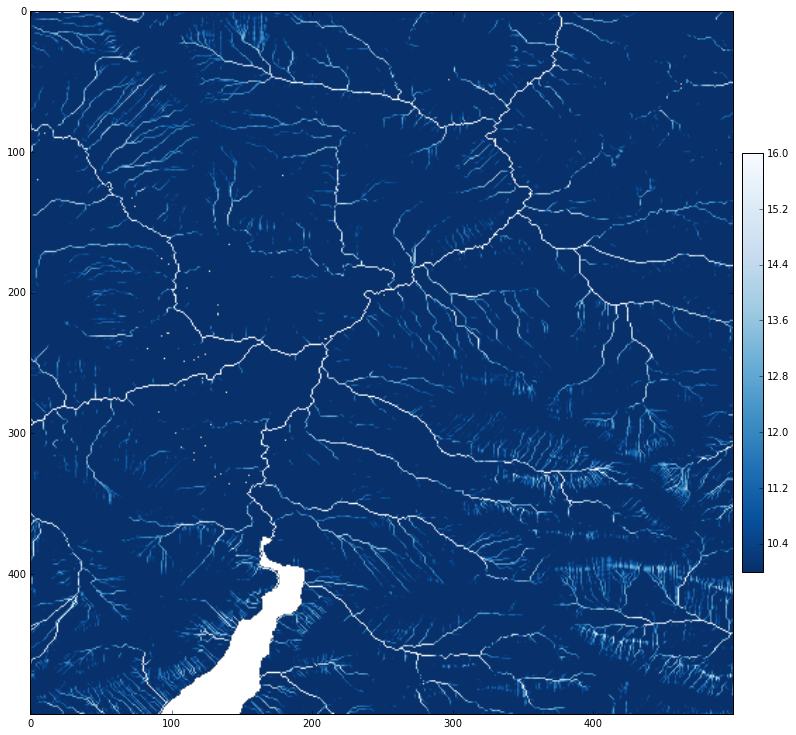

In [25]:
show_drained_slope(power_fa=1.4, power_slope=2)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:5: RuntimeWarning: divide by zero encountered in log


None

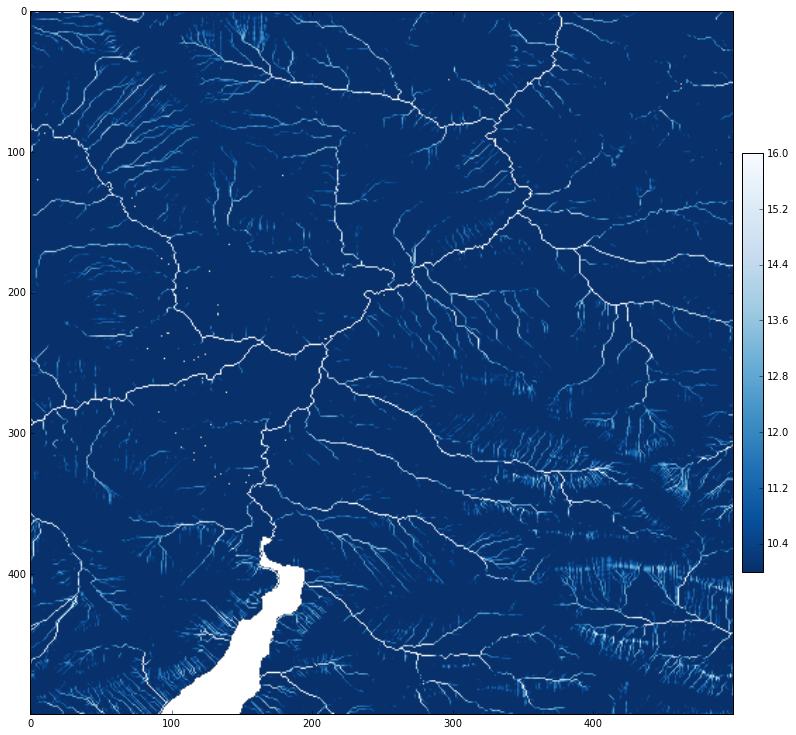

In [19]:

from IPython.html.widgets import interact, interactive, fixed
from IPython.html import widgets
_ = interact(show_drained_slope, power_fa=(-2,2,0.1), power_slope=(-2,2,0.1))

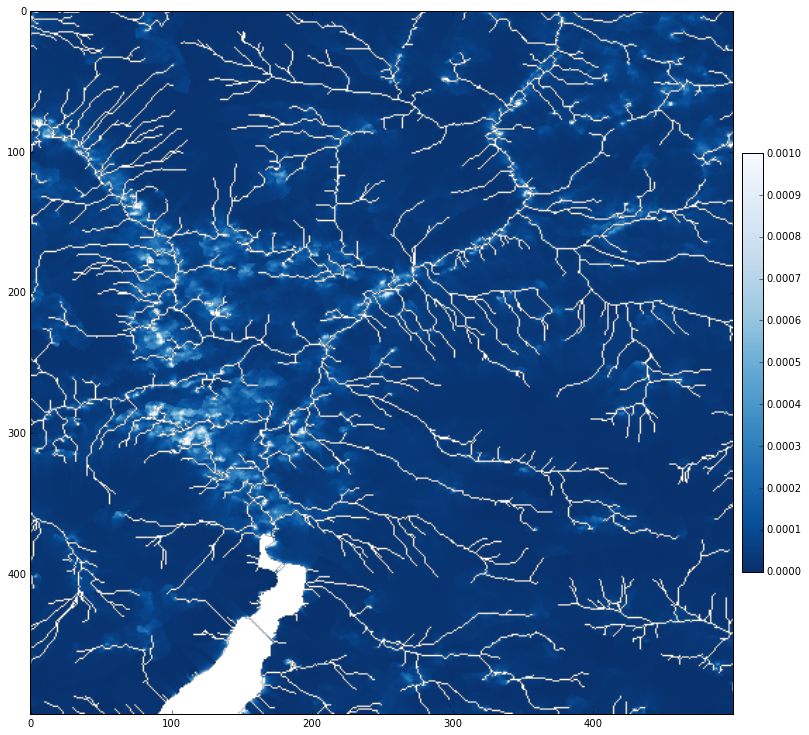

In [31]:
dist_nz = dist[ymin:ymax, xmin:xmax]
hand_nz = hand[ymin:ymax, xmin:xmax]
slope_hand = dist_nz/hand_nz
im = plt.imshow(slope_hand, cmap='Blues_r', vmin=0.0, vmax=0.001)
plt.colorbar(im, shrink=0.5, pad = 0.01)

/usr/local/lib/python2.7/dist-packages/ipykernel/__main__.py:1: RuntimeWarning: divide by zero encountered in log
  if __name__ == '__main__':


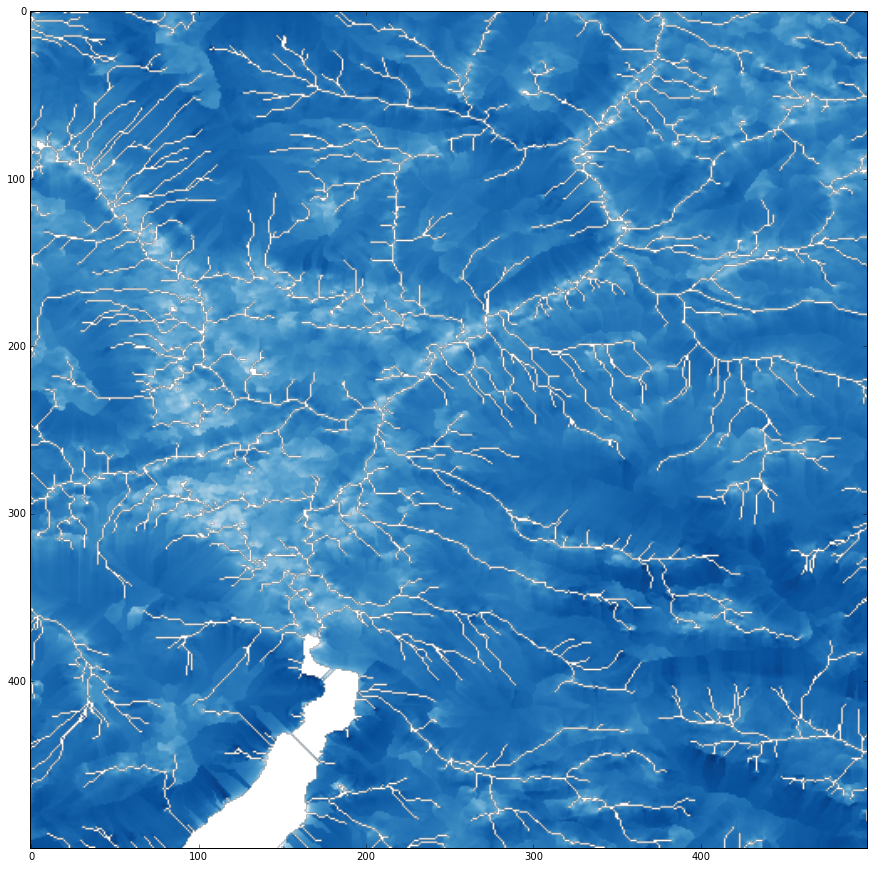

In [446]:
plt.imshow(np.log(slope_hand), cmap='Blues_r')

In [10]:
# generate HAND and DIST using FA=500 and FA=1000
def generate_HAND(max_fa):
    stream_pcr = pcr.ifthenelse(pcr.accuflux(ldd_pcr, 1) >= max_fa, pcr.boolean(1), pcr.boolean(0))
    stream = pcr.pcr_as_numpy(stream_pcr)
    stream = ma.masked_equal(stream, 255)
    stream = ma.masked_equal(stream, 0)

    height_river_pcr = pcr.ifthenelse(stream_pcr, pcr.ordinal(dem_pcr), 0)
    up_elevation_pcr = pcr.scalar(pcr.subcatchment(ldd_pcr, height_river_pcr))

    hand_new_pcr = pcr.max(dem_pcr-up_elevation_pcr, 0)
    hand_new = pcr.pcr_as_numpy(hand_new_pcr)

    # dist = pcr.ldddist(ldd, stream, 1)
    # facc_river = pcr.ifthenelse(stream, pcr.ordinal(flowaccu), 0)
    # up_flowaccu = pcr.scalar(pcr.subcatchment(ldd, facc_river))
    
    return hand_new

In [12]:
from matplotlib.colors import LightSource, Normalize

# def show_hs(im, vmin, vmax):
#     ls = LightSource(azdeg=315, altdeg=70)
#     rgb = ls.shade(im, cmap=plt.cm.gist_earth, 
#                blend_mode='overlay', vert_exag=0.3, vmin=vmin, vmax=vmax)
#    plt.imshow(rgb)

def get_hs(im, color_im, vmin, vmax):
    ls = LightSource(azdeg=315, altdeg=40)
    
    z_color = color_im

    norm = Normalize(vmin, vmax)
    cmap = plt.cm.gist_earth

    return ls.shade_rgb(cmap(norm(z_color)), im, blend_mode='overlay', vert_exag=0.3)

def show_HAND(max_fa):
    hand_new = generate_HAND(max_fa)
    
    # im = plt.imshow(hand_new[ymin:ymax, xmin:xmax], cmap=plt.cm.gist_earth, vmin=0, vmax=500)
    rgb = get_hs(dem[ymin:ymax, xmin:xmax], hand_new[ymin:ymax, xmin:xmax], 0, 500)
    plt.imshow(rgb)    
    
    # plt.imshow(stream[ymin:ymax, xmin:xmax], interpolation='none', cmap=plt.cm.Reds)
    plt.imshow(ma.masked_less(fa[ymin:ymax, xmin:xmax], max_fa), cmap=plt.cm.Reds, vmin=100, vmax=10000, interpolation='none')
    

In [105]:
# Nobre, 2008 analysed HAND in his paper for thresholds: 5, 50, 500 and then 5, 47, 50, 92, 500
# which is for 30m equal to 45, 450, 4500
# we compute HAND for the following threshold: 100, 500, 1000, 5000

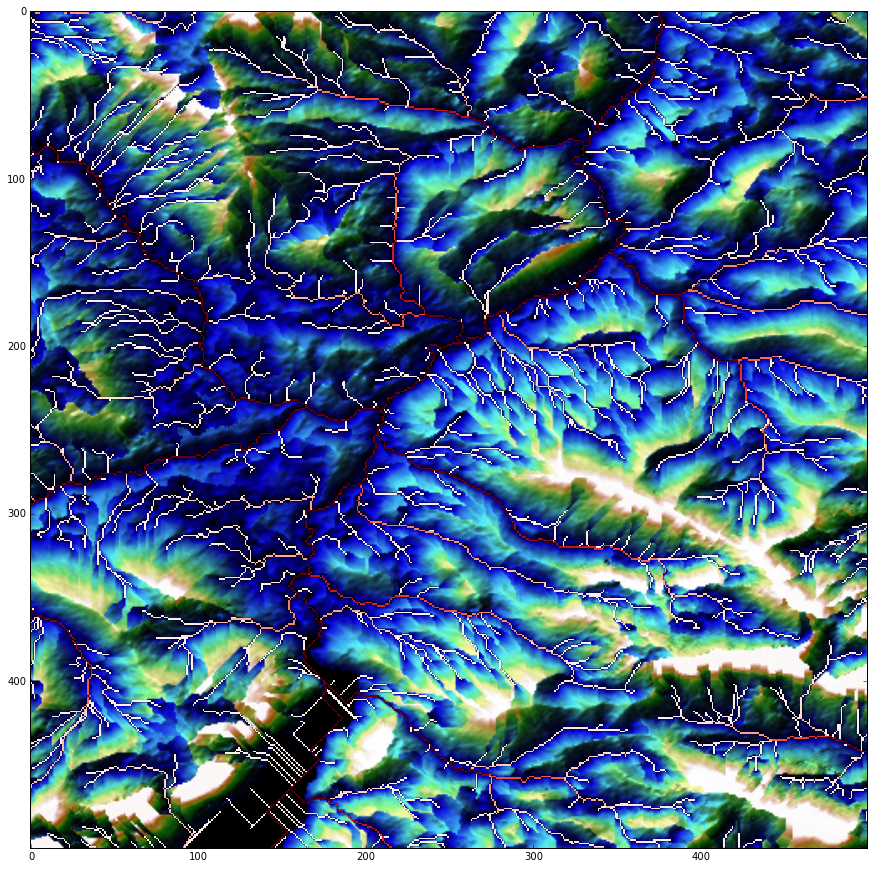

In [211]:
show_HAND(100)

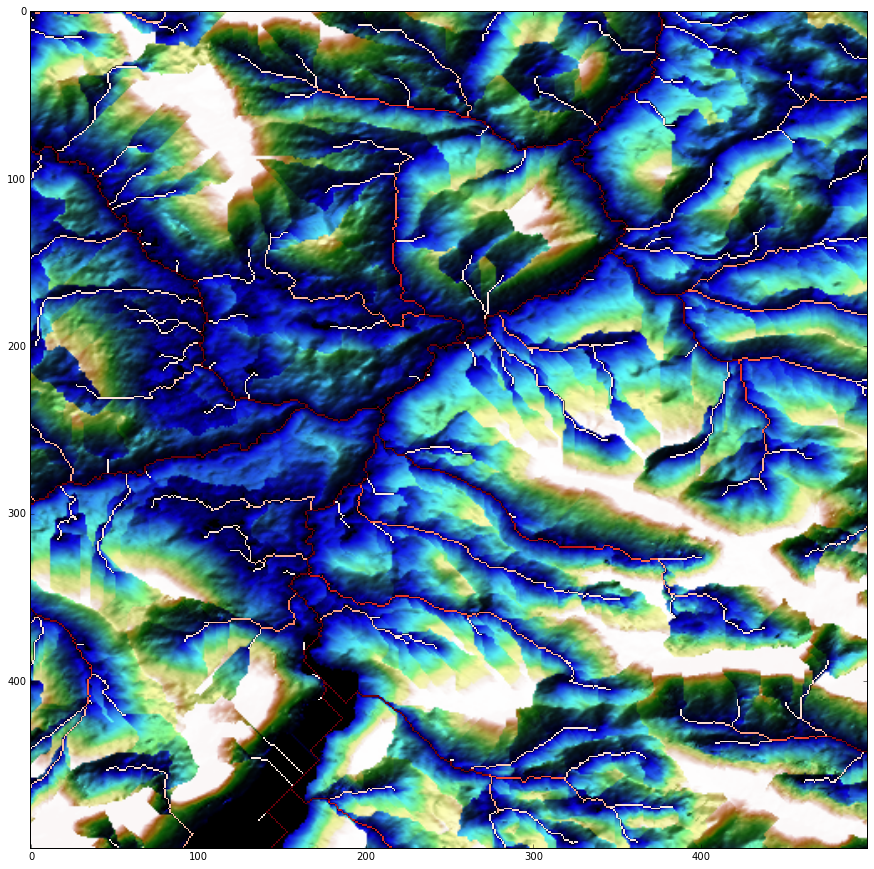

In [197]:
show_HAND(500)

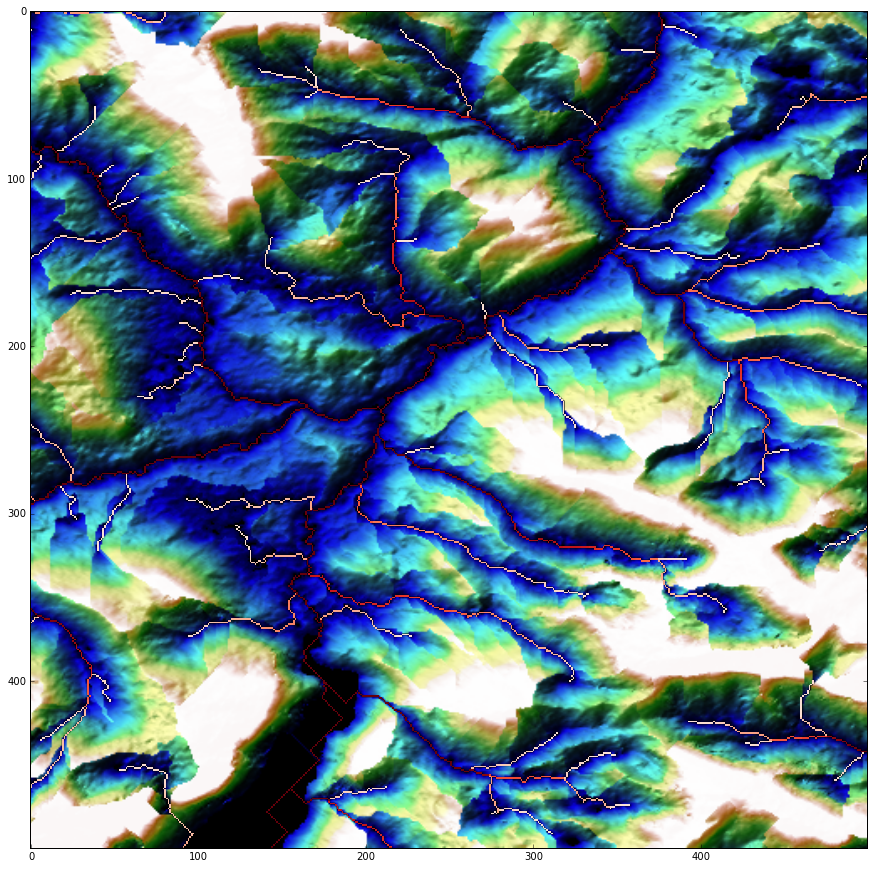

In [198]:
show_HAND(1000)

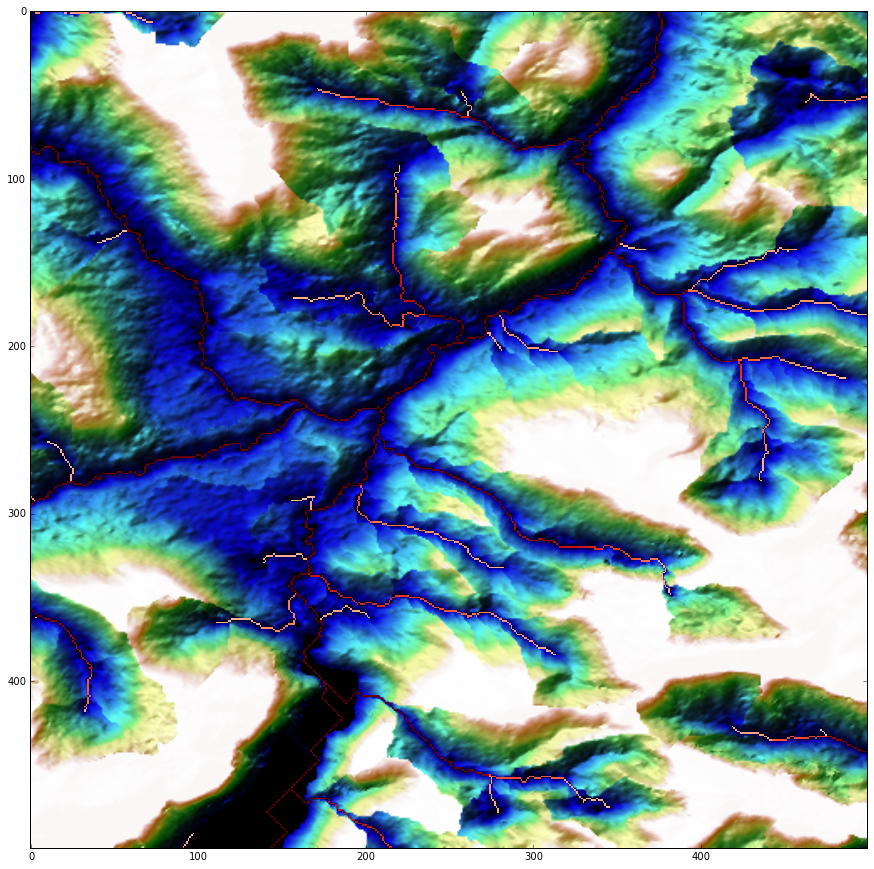

In [199]:
show_HAND(2500)

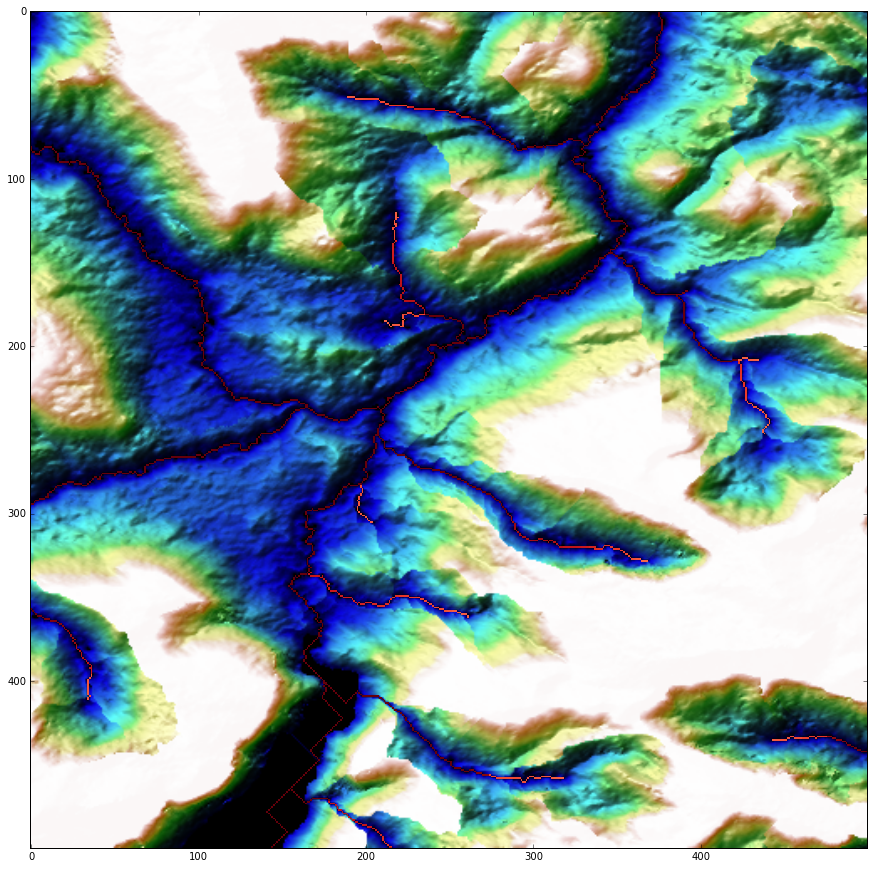

In [200]:
show_HAND(5000)

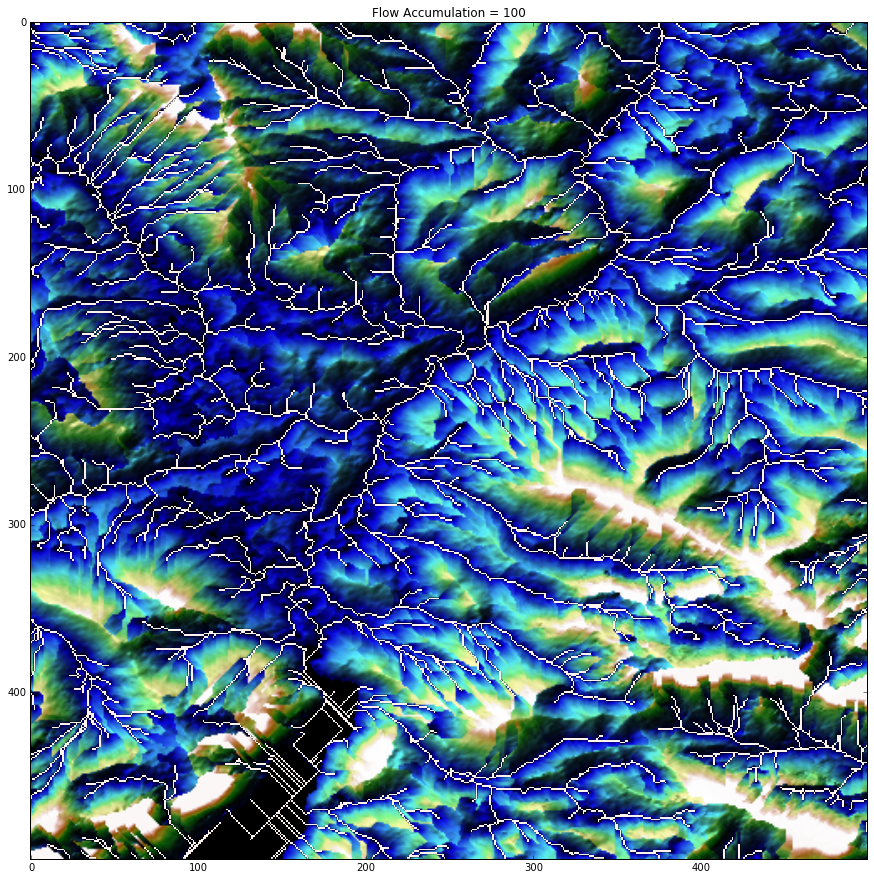

In [70]:
from matplotlib import animation
from matplotlib.colors import LightSource, Normalize

fig, ax = plt.subplots()

th = 100

hand_new = generate_HAND(th)
rgb = get_hs(dem[ymin:ymax, xmin:xmax], hand_new[ymin:ymax, xmin:xmax], 0, 500)
im_hand = plt.imshow(rgb) 
    
im_fa = plt.imshow(ma.masked_less(fa[ymin:ymax, xmin:xmax], th), cmap=plt.cm.Reds, 
                   vmin=0, vmax=10000000, interpolation='none')

ax.set_title('Flow Accumulation = ' + str(th))

plt.show()

In [68]:
import gc
gc.collect()

9

In [69]:
# animated hand

th = 1000
  
# animation function.  This is called sequentially
def animate_HAND(i):
    gc.collect()
    
    fa_th = th + i * 10
    
    print(fa_th)
    ax.set_title('Flow Accumulation = ' + str(fa_th))

    hand_new = generate_HAND(fa_th)
    rgb = get_hs(dem[ymin:ymax, xmin:xmax], hand_new[ymin:ymax, xmin:xmax], 0, 500)
    im_hand.set_data(rgb)
    
    im_fa.set_data(ma.masked_less(fa[ymin:ymax, xmin:xmax], fa_th))

    return [im_hand, im_fa]

# call the animator.  blit=True means only re-draw the parts that have changed.
anim = animation.FuncAnimation(fig, animate_HAND, frames=100, interval=1)

# save the animation as an mp4.  This requires ffmpeg or mencoder to be
# installed.  The extra_args ensure that the x264 codec is used, so that
# the video can be embedded in html5.  You may need to adjust this for
# your system: for more information, see
# http://matplotlib.sourceforge.net/api/animation_api.html
anim.save('../temp/HAND.mp4', fps=15, codec='libx264')


plt.show()

1000
1000
1010
1020
1030
1040
1050
1060
1070
1080
1090
1100
1110
1120
1130
1140
1150
1160
1170
1180
1190
1200
1210
1220
1230
1240
1250
1260
1270
1280
1290
1300
1310
1320
1330
1340
1350
1360
1370
1380
1390
1400
1410
1420
1430
1440
1450
1460
1470
1480
1490
1500
1510
1520
1530
1540
1550
1560
1570
1580
1590
1600
1610
1620
1630
1640
1650
1660
1670
1680
1690
1700
1710
1720
1730
1740
1750
1760
1770
1780
1790
1800
1810
1820
1830
1840
1850
1860
1870
1880
1890
1900
1910
1920
1930
1940
1950
1960
1970
1980
1990


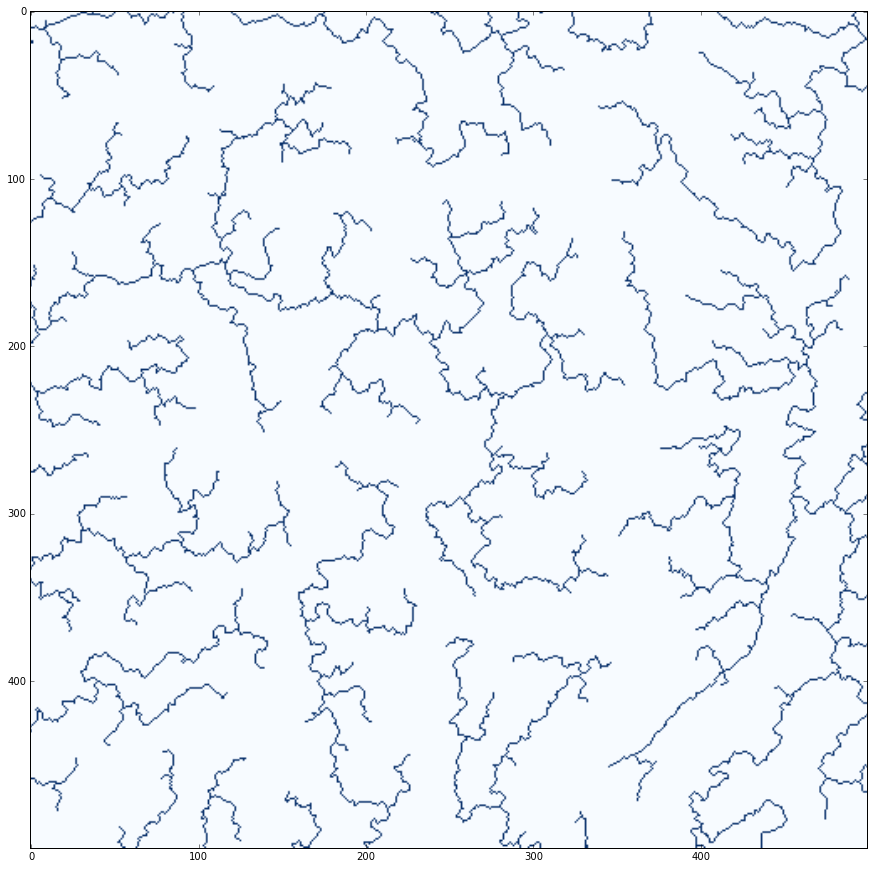

In [7]:
fa = pcr.readmap('SRTM_30_Africa_1050022430_fa.map')
fa_threshold = 500
    
ldd = pcr.ldd(pcr.readmap('SRTM_30_Africa_1050022430_ldd.map'))

fa_th = fa >= fa_threshold
stream = pcr.ifthenelse(fa_th, pcr.boolean(1), pcr.boolean(0))

plt.imshow(pcr.pcr2numpy(stream, -9999)[2000:2500, 2000:2500], cmap=plt.cm.Blues)

In [11]:
streamorder=pcr.streamorder(ldd)
streamorder_np=pcr.pcr2numpy(streamorder, -9999)

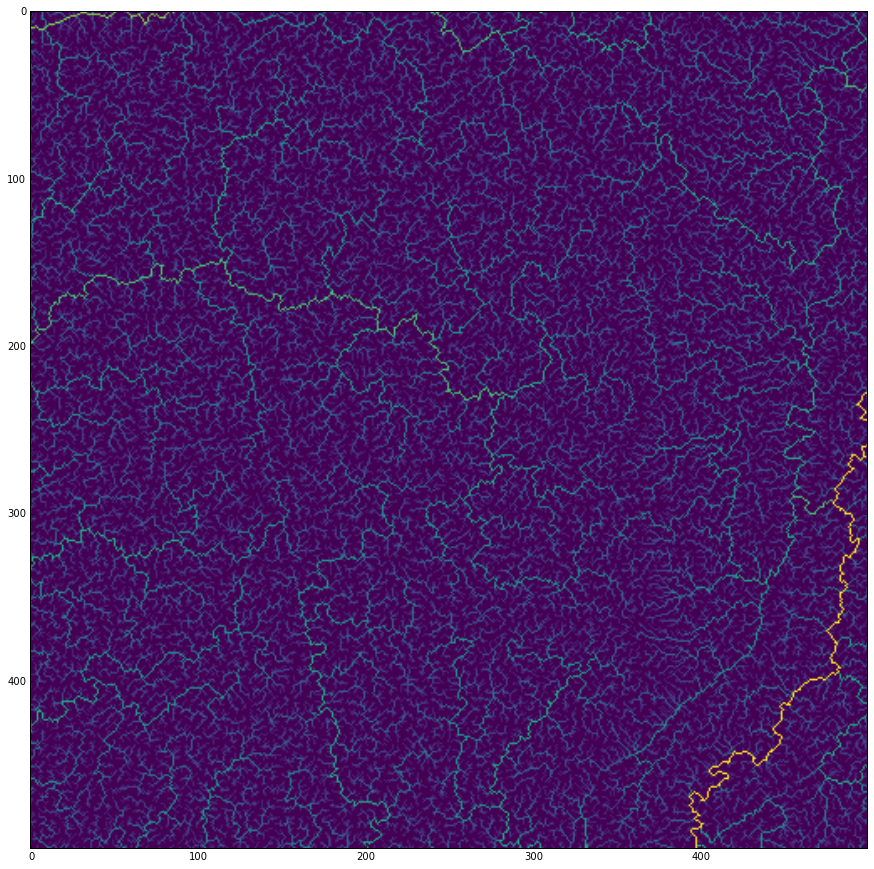

In [30]:
so=streamorder_np[2000:2500, 2000:2500]
im=plt.imshow(so, cmap=plt.cm.viridis)
# plt.colorbar(im, shrink=0.5, pad = 0.01)